In [70]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy import optimize
import seaborn as sns

In [71]:
# Выгружаем датасет

file_path = '/Users/aleksandrbogdanov/MyJupyterNotebook/Datasets/ККД.xlsx'
data = pd.read_excel(file_path)
data["Капиллярное давление, МПа"] = data["Капиллярное давление, атм"] * 0.101
data

,Скважина,Лабораторный номер архивный,Пласт,"Кпр, мД","Кп, %","Капиллярное давление, атм","Текущая водонасыщенность Кв, %","Капиллярное давление, МПа"
0,9791,891-9791-182,ЮШ6 (Ю6),0.15,9.380000,0.163000,99.690000,0.016463
1,9791,891-9791-182,ЮШ6 (Ю6),0.15,9.380000,0.490000,98.920000,0.049490
2,9791,891-9791-182,ЮШ6 (Ю6),0.15,9.380000,0.981000,97.380000,0.099081
3,9791,891-9791-182,ЮШ6 (Ю6),0.15,9.380000,1.962000,93.760000,0.198162
4,9791,891-9791-182,ЮШ6 (Ю6),0.15,9.380000,3.435000,86.080000,0.346935
...,...,...,...,...,...,...,...,...
342,10703,927-10703-4п,NaN,465.56,20.128138,5.032348,16.164912,0.508267
343,10703,927-10703-4п,NaN,465.56,20.128138,7.046002,15.222873,0.711646
344,10703,927-10703-4п,NaN,465.56,20.128138,10.065258,14.849300,1.016591
345,10703,927-10703-4п,NaN,465.56,20.128138,15.095744,14.554137,1.524670


In [72]:
data =data[data['Капиллярное давление, МПа'] !=0.0]
data

,Скважина,Лабораторный номер архивный,Пласт,"Кпр, мД","Кп, %","Капиллярное давление, атм","Текущая водонасыщенность Кв, %","Капиллярное давление, МПа"
0,9791,891-9791-182,ЮШ6 (Ю6),0.15,9.380000,0.163000,99.690000,0.016463
1,9791,891-9791-182,ЮШ6 (Ю6),0.15,9.380000,0.490000,98.920000,0.049490
2,9791,891-9791-182,ЮШ6 (Ю6),0.15,9.380000,0.981000,97.380000,0.099081
3,9791,891-9791-182,ЮШ6 (Ю6),0.15,9.380000,1.962000,93.760000,0.198162
4,9791,891-9791-182,ЮШ6 (Ю6),0.15,9.380000,3.435000,86.080000,0.346935
...,...,...,...,...,...,...,...,...
342,10703,927-10703-4п,NaN,465.56,20.128138,5.032348,16.164912,0.508267
343,10703,927-10703-4п,NaN,465.56,20.128138,7.046002,15.222873,0.711646
344,10703,927-10703-4п,NaN,465.56,20.128138,10.065258,14.849300,1.016591
345,10703,927-10703-4п,NaN,465.56,20.128138,15.095744,14.554137,1.524670


In [4]:
data

,Скважина,Лабораторный номер архивный,Пласт,"Кпр, мД","Кп, %","Капиллярное давление, атм","Текущая водонасыщенность Кв, %","Капиллярное давление, МПа"
0,9791,891-9791-182,ЮШ6 (Ю6),0.15,9.380000,0.163000,99.690000,0.016463
1,9791,891-9791-182,ЮШ6 (Ю6),0.15,9.380000,0.490000,98.920000,0.049490
2,9791,891-9791-182,ЮШ6 (Ю6),0.15,9.380000,0.981000,97.380000,0.099081
3,9791,891-9791-182,ЮШ6 (Ю6),0.15,9.380000,1.962000,93.760000,0.198162
4,9791,891-9791-182,ЮШ6 (Ю6),0.15,9.380000,3.435000,86.080000,0.346935
...,...,...,...,...,...,...,...,...
342,10703,927-10703-4п,NaN,465.56,20.128138,5.032348,16.164912,0.508267
343,10703,927-10703-4п,NaN,465.56,20.128138,7.046002,15.222873,0.711646
344,10703,927-10703-4п,NaN,465.56,20.128138,10.065258,14.849300,1.016591
345,10703,927-10703-4п,NaN,465.56,20.128138,15.095744,14.554137,1.524670


In [73]:
# Посмотрим сколько скважин и образцов

info = data.groupby(by=['Скважина','Лабораторный номер архивный']).size()
info

Скважина  Лабораторный номер архивный
10703     927-10703-126                  10
          927-10703-129                  10
          927-10703-4п                   10
10704     2041                            7
          2041.1                          7
          2042                            7
          2043                            7
          2044                            7
          2045                            7
          2046                            7
          2120                            7
10670П    113-10670-316                   7
          113-10670-317                   7
          113-10670-44                   10
          113-10670-45                    7
          113-10670-46                   10
          113-10670-48                   10
          113-10670-49                   10
          113-10670-50                   10
          113-10670-51                   10
10692Р    891-10692-123                   7
          891-10692-124               

In [74]:
samples = data.groupby(by=['Лабораторный номер архивный'])

In [75]:
# Создадим словарь, где значениями будут номера образцов, а значениями - словари со 
#значениями Кп, Кпр, Рс и Ков

sample_dict = {}

for name in samples:
    sample_dict[name[0][0]] = {'Кпр' : np.array(name[1]['Кпр, мД'].values),
                              'Кп': np.array(name[1]['Кп, %'].values),
                              'Pc': np.array(name[1]['Капиллярное давление, МПа'].values),
                              'Кв': np.array(name[1]['Текущая водонасыщенность Кв, %'].values)
}
sample_dict

{2041: {'Кпр': array([5.87, 5.87, 5.87, 5.87, 5.87, 5.87, 5.87]),
  'Кп': array([17.6, 17.6, 17.6, 17.6, 17.6, 17.6, 17.6]),
  'Pc': array([0.0379053, 0.0852844, 0.1516212, 0.2866481, 0.4643273, 0.6846487,
         0.9476123]),
  'Кв': array([82.57350958, 62.31454006, 49.04235231, 42.78392231, 38.52171567,
         34.74507688, 32.42514162])},
 2041.1: {'Кпр': array([5.01, 5.01, 5.01, 5.01, 5.01, 5.01, 5.01]),
  'Кп': array([17.21, 17.21, 17.21, 17.21, 17.21, 17.21, 17.21]),
  'Pc': array([0.0377639, 0.0849713, 0.1510556, 0.2855876, 0.4626103, 0.6821136,
         0.9440975]),
  'Кв': array([85.12465374, 60.49861496, 48.94736842, 42.54847645, 38.64265928,
         34.95844875, 32.27146814])},
 2042: {'Кпр': array([0.78, 0.78, 0.78, 0.78, 0.78, 0.78, 0.78]),
  'Кп': array([14.54, 14.54, 14.54, 14.54, 14.54, 14.54, 14.54]),
  'Pc': array([0.0374811, 0.084335 , 0.1499345, 0.2834666, 0.4591662, 0.6770333,
         0.937078 ]),
  'Кв': array([94.79406919, 82.1416804 , 70.34596376, 63.2289950

In [333]:
# Визуализируем все полученные капиллярные кривые
from matplotlib.gridspec import GridSpec

fig = plt.figure(figsize=(20,80), dpi=200)

nrows = 14
ncols = 3

gs = GridSpec(nrows, ncols, fig)

rows = [i for i in range(14)]

count_cols = 0

for samp in sample_dict:
    
    # рисуем графики
    ax = fig.add_subplot(gs[rows[0], count_cols])
    
    if samp == '927-10703-126' or samp == '927-10703-129' or samp == '927-10703-4п':
        Sw = sample_dict[samp]['Кв'][1:]
        Pc = sample_dict[samp]['Pc'][1:]
    else:
        Sw = sample_dict[samp]['Кв']
        Pc = sample_dict[samp]['Pc']
        
    ax.plot(Sw, Pc, marker = 'o', color = 'b')
        
    ax.set_title(f'Образец {samp}')
        
    ax.set_xlabel('Ков, %')
    ax.set_ylabel('Pc, МПа')
    ax.set_yscale('log')
        
    ax.set_xlim(0, 105) 
    ax.set_ylim(10**-1.3, 10**1.4)
        
    ax.grid()
    
    count_cols+=1
    if count_cols > 2:
        rows = rows[1:]
        count_cols = 0
    
    if len(rows) == 0:
        break
    
        
    
plt.tight_layout()     

[ 0.18  0.41  1.    2.    3.5   5.    7.16  9.97 14.95 20.01]
[ 0.18  0.41  1.01  2.01  3.52  5.03  7.21 10.03 15.04 20.13]
[ 0.41422681  1.00669143  2.01283195  3.52186884  5.03234754  7.04600178
 10.06525824 15.09574381 20.12883619]


In [76]:
# Модель Брукса-Кори

def brux_cory(Pc, Sw_min, P_woc, n):
    return Sw_min+(100-Sw_min)*(P_woc/Pc)**(1/n)

In [77]:
def error_function(n, Sw, Pc, Sw_min, P_woc):
    pred_Sw = brux_cory(Pc, Sw_min, P_woc, n)
    error = Sw - pred_Sw
    return error

In [78]:
from scipy.optimize import least_squares

cory_dict = {}


for samp in sample_dict:

    Sw = sample_dict[samp]['Кв']
    Pc = sample_dict[samp]['Pc']

    Swi = Sw.min()
    
    n = [1]
    
    first_diff = []
    
    for i in range(len(Sw)-1):
        value = (Pc[i] - Pc[i-1])/(Sw[i] - Sw[i-1])
        first_diff.append(value)
    
    second_diff = []
    for i in range(len(first_diff)-1):
        value = (first_diff[i] - first_diff[i-1])/(Sw[i] - Sw[i-1])
        second_diff.append(value)

    
    for i in range(len(Sw[2:])):
        if Sw[i] >= 70 and second_diff[i] != 0 :
            Pd_index = second_diff.index(max(second_diff)) + 2
            Pd = Pc[Pd_index]
        else:
            Pd = min(Pc)

    # Поиск решения методом МНК
    fit_mask = (Pc >= Pd)

    opt = least_squares(error_function, [1], args=(Sw[fit_mask], Pc[fit_mask], Swi, Pd))
    res = brux_cory(Pc, Swi, Pd, opt.x[0])

    for i in range(len(res)):
        if res[i] >= 100:
            res[i] = 100
        if res[i] <= 0:
            res[i] = 0
            
    cory_dict[samp] = res
    
#     Pk = (Pc>=P_woc)
#     opimization = least_squares(error_function, n, args=(Sw[Pk], Pc[Pk], Sw_min, P_woc))
#     print(opimization.x[0])
#     n_par_ar.append(opimization.x[0])
#     brux_cory_result = brux_cory(Pc, Sw_min, P_woc, opimization.x[0])
#     cory_dict[samp] = brux_cory_result
    
cory_dict
    
    

{2041: array([100.        ,  62.26305883,  49.13058597,  41.21603304,
         37.83099602,  36.07988966,  35.05876315]),
 2041.1: array([100.        ,  61.68971908,  48.55267541,  40.72936368,
         37.42212716,  35.72650388,  34.74490413]),
 2042: array([100.        ,  78.28666013,  68.80587651,  61.89294957,
         58.3490436 ,  56.24056289,  54.86240275]),
 2043: array([100.        ,  59.7543225 ,  46.40533308,  38.67474495,
         35.43716167,  33.89476481,  32.98488285]),
 2044: array([100.        ,  72.26805384,  61.17191118,  53.65611913,
         50.10863133,  48.03865171,  46.77216384]),
 2045: array([100.        ,  85.05069095,  69.91555886,  60.52692942,
         56.39996006,  54.21909416,  52.92518011]),
 2046: array([100.        ,  72.58052061,  61.45305592,  53.82510634,
         50.13688002,  48.03947445,  46.71819506]),
 2120: array([100.        ,  88.32129957,  75.48322018,  66.60403834,
         62.27495902,  59.79739327,  58.22851705]),
 '113-10670-316': arra

In [12]:
# Визуализируем все полученные капиллярные кривые
from matplotlib.gridspec import GridSpec

fig = plt.figure(figsize=(20,80), dpi=200)

nrows = 14
ncols = 3

gs = GridSpec(nrows, ncols, fig)

rows = [i for i in range(14)]

count_cols = 0

for_cory = [i for i in range(42)]

for samp in sample_dict:
    
    # рисуем графики
    ax = fig.add_subplot(gs[rows[0], count_cols])
    
    Sw = sample_dict[samp]['Кв']
    Pc = sample_dict[samp]['Pc']
        
    ax.plot(Sw, Pc, marker = 'o', color = 'b', label = 'Фактическая кривая')
    
    approx_array = np.zeros(len(Sw))
    cory_array = cory_dict[samp]
    
#     for i in range(len(Sw)):
#         if cory_array[i] >= 100:
#             approx_array[i] = Sw[i] + 10
#         else:
#             approx_array[i] = cory_array[i]
    
    ax.plot(cory_array,
            Pc, marker = 'o', color = 'r', ls = ':', label = 'Брукс-Кори')
        
    ax.set_title(f'Образец {samp}')
        
    ax.set_xlabel('Ков, %')
    ax.set_ylabel('Pc, МПа')
    ax.set_yscale('log')
        
    ax.set_xlim(0, 105) 
    ax.set_ylim(10**-2, 10**1.4)
        
    ax.legend()
    ax.grid()
    
    
    
    count_cols+=1
    if count_cols > 2:
        rows = rows[1:]
        count_cols = 0
    
    if len(rows) == 0:
        break
    
        
    
plt.tight_layout()     

Кинетическая модель

In [79]:
# Модель Кинетическая

def kinetic(params, Pc, Swi, Pd, Pc_kvo):
    a,b = params
    return ((Pc-Pc_kvo)/((Pd-Pc)*a))**(1/b)+Swi


In [80]:
def kinetic_error(params, Pc, Swi, Sw, Pd, Pc_kvo):
    a,b = params 
    return Sw - kinetic(params, Pc, Swi, Pd, Pc_kvo)

In [81]:
from scipy.optimize import least_squares

kinetic_dict = {}

for samp in sample_dict:

    Sw = sample_dict[samp]['Кв']
    Pc = sample_dict[samp]['Pc']
    
    Swi = Sw.min()

    Pc_kvo = Pc.max() 

    first_diff = []
    for i in range(len(Sw)-1):
        value = (Pc[i] - Pc[i-1])/(Sw[i] - Sw[i-1])
        first_diff.append(value)

    second_diff = []
    for i in range(len(first_diff)-1):
        value = (first_diff[i] - first_diff[i-1])/(Sw[i] - Sw[i-1])
        second_diff.append(value)
    

    for i in range(len(Sw[2:])):
        if Sw[i] >= 70 and second_diff[i] != 0 :
            Pd_index = second_diff.index(max(second_diff)) + 2
            Pd = Pc[Pd_index] + 0.0005
        else:
            Pd = min(Pc) + 0.0005
            

    fit_mask = (Pc > Pd)
    x0 = np.array([1.0, 1.0])
    
    b0 = (0,1)
    b1 = (1,10)
    bounds=(b0, b1)
    result = least_squares(kinetic_error, x0, args=(Pc[fit_mask], Swi, Sw[fit_mask], Pd, Pc_kvo), 
                           bounds=(b0, b1))
    final_res = kinetic(result.x, Pc, Swi, Pd, Pc_kvo)

    # Построение графика по значениям функции модели
    for i in range(len(final_res)):
        final_res[i] = abs(final_res[i])
        if final_res[i] >= 100:
            final_res[i] = 100
        
    kinetic_dict[samp] = final_res
        
#     P_woc = woc_prec_sw_dict[samp][1]
#     Sw_min = Kov_pc_sw[samp][0]
#     P_max = Kov_pc_sw[samp][1]
#     initial_guess = np.array([0.5, 0.8])  # Используем np.array для создания массива numpy

#     Pk = Pc >= P_woc
#     optimization = least_squares(kinetic_error, initial_guess, args=(Sw[Pk], Pc[Pk], Sw_min, P_woc, P_max))
#     print(optimization.x)
#     kinetic_result = kinetic(Sw, Sw_min, P_woc, P_max, optimization.x)
#     kinetic_dict[samp] = kinetic_result

kinetic_dict

/var/folders/46/4js24d154nb0rgs9sp2kxk180000gn/T/ipykernel_15937/4232844766.py:5: RuntimeWarning: invalid value encountered in power
  return ((Pc-Pc_kvo)/((Pd-Pc)*a))**(1/b)+Swi


{2041: array([        nan, 62.27491214, 49.4340523 , 42.06495563, 38.27902577,
        35.63874082, 32.42514162]),
 2041.1: array([        nan, 60.56586963, 48.99425277, 42.10457907, 38.43913777,
        35.79168633, 32.27146814]),
 2042: array([        nan, 82.40794915, 70.09700572, 62.31833324, 57.93786444,
        54.58785058, 49.39044481]),
 2043: array([        nan, 57.91521695, 46.97348414, 40.40043792, 36.79892625,
        34.30362949, 30.80862534]),
 2044: array([        nan, 75.29157919, 61.78562763, 53.79945944, 49.63708315,
        46.54951286, 42.5891182 ]),
 2045: array([        nan, 83.00524913, 69.06554586, 62.19737336, 58.40518101,
        55.36728415, 49.3923025 ]),
 2046: array([        nan, 76.35445167, 62.19281791, 53.8481374 , 49.45170074,
        46.30700607, 42.22883598]),
 2120: array([        nan, 89.33912937, 75.26115249, 68.00445311, 63.8490571 ,
        60.40275273, 52.78481013]),
 '113-10670-316': array([  nan,   nan,   nan,   nan, 73.23, 63.54, 57.29]),
 '

In [162]:
# Визуализируем все полученные капиллярные кривые
from matplotlib.gridspec import GridSpec

fig = plt.figure(figsize=(20,80), dpi=200)

nrows = 14
ncols = 3

gs = GridSpec(nrows, ncols, fig)

rows = [i for i in range(14)]

count_cols = 0

for_cory = [i for i in range(42)]

for samp in sample_dict:
    
    # рисуем графики
    ax = fig.add_subplot(gs[rows[0], count_cols])
    
    Sw = sample_dict[samp]['Кв']
    Pc = sample_dict[samp]['Pc']
        
    ax.plot(Sw, Pc, marker = 'o', color = 'b', label = 'Фактическая кривая')

    approx_array = np.zeros(len(Sw))
    kinetic_array = kinetic_dict[samp]
    
#     for i in range(len(Pc)):
#         if kinetic_array[i] > Pc[i] + 0.2:
#             approx_array[i] = Pc[i] + 0.05
#         else:
#             approx_array[i] = kinetic_array[i]
    
    ax.plot(kinetic_array, Pc, marker = 'o', color = 'r', ls = ':', label = 'Кинетическая')
        
    ax.set_title(f'Образец {samp}')
        
    ax.set_xlabel('Ков, %')
    ax.set_ylabel('Pc, МПа')
    ax.set_yscale('log')
        
    ax.set_xlim(0, 105) 
    ax.set_ylim(10**-2, 10**1.4)
        
    ax.legend()
    ax.grid()
    
    
    
    count_cols+=1
    if count_cols > 2:
        rows = rows[1:]
        count_cols = 0
    
    if len(rows) == 0:
        break
    
        
    
plt.tight_layout()     

Оптимальная модель

In [82]:
# Модель Оптимальная

def optimal(params, Pc, Swi):
    a,b = params
    alpha = (Pc/a)**(1/b)
    return (alpha * Swi + 100)/(1+alpha)

In [83]:
def optimal_error(params, Pc, Swi, Sw):
    a, b = params
    return Sw - optimal(params, Pc, Swi)

In [84]:

from scipy.optimize import least_squares

optimal_dict = {}


for samp in sample_dict:

    Sw = sample_dict[samp]['Кв']
    Pc = sample_dict[samp]['Pc']
    
    Swi = Sw.min() - 0.05
   
    x0 = np.array([1, 1])
    b0 = (0,0)
    b1 = (1,1)
    bounds=(b0, b1)
    result = least_squares(optimal_error, x0, args = (Pc, Swi, Sw), 
                           bounds=(b0, b1))
    final_res = optimal(result.x, Pc, Swi)

    # Построение графика по значениям функции модели
    for i in range(len(final_res)):
        final_res[i] = abs(final_res[i])
        if final_res[i] >= 100:
            final_res[i] = 100
            
    optimal_dict[samp] = final_res
        

optimal_dict

{2041: array([81.62174741, 63.07048158, 50.35681563, 40.91032412, 36.91693006,
        35.04496225, 34.07016625]),
 2041.1: array([82.61690965, 63.21776623, 49.82123292, 40.17318507, 36.28282686,
        34.53095115, 33.6479507 ]),
 2042: array([93.18533371, 82.67899257, 72.12736493, 61.5307251 , 56.1234694 ,
        53.38408572, 51.91206221]),
 2043: array([78.789812  , 59.85794398, 47.66505092, 38.83469881, 35.04657737,
        33.34903177, 32.42230913]),
 2044: array([90.79873477, 76.48357405, 63.58149238, 52.50045098, 47.69130168,
        45.40421326, 44.28233586]),
 2045: array([89.32707398, 83.7712733 , 72.83614372, 61.63293879, 55.98813158,
        53.19927414, 51.73818844]),
 2046: array([90.98007435, 76.96560993, 64.1016559 , 52.76715517, 47.67074264,
        45.295169  , 44.08864366]),
 2120: array([93.17035706, 89.02253082, 79.61098476, 67.98584842, 61.27075541,
        57.74237823, 55.84727132]),
 '113-10670-316': array([99.99874477, 99.93178166, 99.56619571, 95.16087308, 7

In [19]:
# Визуализируем все полученные капиллярные кривые
from matplotlib.gridspec import GridSpec

fig = plt.figure(figsize=(20,80), dpi=200)

nrows = 14
ncols = 3

gs = GridSpec(nrows, ncols, fig)

rows = [i for i in range(14)]

count_cols = 0

for_cory = [i for i in range(42)]

for samp in sample_dict:
    
    # рисуем графики
    ax = fig.add_subplot(gs[rows[0], count_cols])

    Sw = sample_dict[samp]['Кв']
    Pc = sample_dict[samp]['Pc']


    ax.plot(Sw, Pc, marker = 'o', color = 'b', label = 'Фактическая кривая')

    optimal_array = optimal_dict[samp]
    
    ax.plot(optimal_array, Pc, marker = 'o', color = 'r', ls = ':', label = 'Оптимальная')
        
    ax.set_title(f'Образец {samp}')
        
    ax.set_xlabel('Ков, %')
    ax.set_ylabel('Pc, МПа')
    ax.set_yscale('log')
        
    ax.set_xlim(0, 105) 
    ax.set_ylim(10**-2.5, 10**1.4)
    ax.legend()
        
    ax.grid()
    
    
    
    count_cols+=1
    if count_cols > 2:
        rows = rows[1:]
        count_cols = 0
    
    if len(rows) == 0:
        break
    
        
    
plt.tight_layout()     

[81.62174741 63.07048158 50.35681563 40.91032412 36.91693006 35.04496225
 34.07016625]
[82.61690965 63.21776623 49.82123292 40.17318507 36.28282686 34.53095115
 33.6479507 ]
[93.18533371 82.67899257 72.12736493 61.5307251  56.1234694  53.38408572
 51.91206221]
[78.789812   59.85794398 47.66505092 38.83469881 35.04657737 33.34903177
 32.42230913]
[90.79873477 76.48357405 63.58149238 52.50045098 47.69130168 45.40421326
 44.28233586]
[89.32707398 83.7712733  72.83614372 61.63293879 55.98813158 53.19927414
 51.73818844]
[90.98007435 76.96560993 64.1016559  52.76715517 47.67074264 45.295169
 44.08864366]
[93.17035706 89.02253082 79.61098476 67.98584842 61.27075541 57.74237823
 55.84727132]
[99.99874477 99.93178166 99.56619571 95.16087308 73.75675598 62.62120148
 58.17869345]
[99.99880631 99.94400858 99.66685063 96.50166469 78.47279694 65.39792505
 58.75172243]
[99.78815009 98.11214511 93.06090644 79.17687833 62.26387512 52.82088056
 46.55915395 43.46800157 40.09382887 39.19403153]
[99.99875

Томира

In [85]:
# Модель Томира

def tomire(Pc, Swi, Pd, G): 
    return Swi+(100-Swi)*(1 - np.exp(G/(np.log(Pd/Pc))))

In [86]:
def tomire_error(G, Sw, Pc, Swi, Pd):
    return Sw-tomire(Pc, Swi, Pd, G)


In [87]:
from scipy.optimize import least_squares

tomire_dict = {}
for samp in sample_dict:
    
    Sw = sample_dict[samp]['Кв']
    Pc = sample_dict[samp]['Pc']
    
    Swi = Sw.min()
    sw_mask = (Sw > 100)
    
    
    first_diff = []
    for i in range(len(Sw)-1):
        value = (Pc[i] - Pc[i-1])/(Sw[i] - Sw[i-1])
        first_diff.append(value)
    
    second_diff = []
    for i in range(len(first_diff)-1):
        value = (first_diff[i] - first_diff[i-1])/(Sw[i] - Sw[i-1])
        second_diff.append(value)
    
    for i in range(len(Sw[2:])):
        if Sw[i] >= 70 and second_diff[i] != 0 :
            Pd_index = second_diff.index(max(second_diff)) + 2
            Pd = Pc[Pd_index] + 0.000005
        else:
            Pd = min(Pc) + 0.000005
    
    fit_mask = (Pc >= Pd)
    result = least_squares(tomire_error, 1, args=((Sw[fit_mask]),(Pc[fit_mask]), Swi, Pd))
    final_res = tomire(Pc, Swi, Pd, result.x[0])

    for i in range(len(final_res)):
        final_res[i] = abs(final_res[i])
        if final_res[i-1] >= 100:
            if final_res[i] == 100:
                final_res[i-1] = 100
            final_res[i-1] = 100
    
    tomire_dict[samp] = final_res

tomire_dict

/var/folders/46/4js24d154nb0rgs9sp2kxk180000gn/T/ipykernel_15937/1823652317.py:4: RuntimeWarning: overflow encountered in exp
  return Swi+(100-Swi)*(1 - np.exp(G/(np.log(Pd/Pc))))


{2041: array([100.        ,  56.7314737 ,  47.93563722,  43.48144638,
         41.50355259,  40.36001417,  39.60295728]),
 2041.1: array([100.        ,  55.97591632,  47.35713699,  43.01101207,
         41.08496556,  39.97242094,  39.23627945]),
 2042: array([100.        ,  76.42665246,  67.62938932,  62.73944213,
         60.47701912,  59.14368052,  58.25081234]),
 2043: array([100.        ,  53.80091545,  45.36770848,  41.14927113,
         39.25129831,  38.21217323,  37.50199478]),
 2044: array([100.        ,  68.82430014,  59.83064878,  55.05043544,
         52.90980084,  51.6163073 ,  50.77318207]),
 2045: array([100.        ,  82.79010689,  66.69393426,  60.56241519,
         58.19023448,  56.90403048,  56.08455289]),
 2046: array([100.        ,  69.34882087,  60.12461281,  55.18834705,
         52.9425392 ,  51.62930136,  50.75398308]),
 2120: array([100.        ,  88.75899643,  72.94142592,  66.11871004,
         63.3799942 ,  61.87338737,  60.90567351]),
 '113-10670-316': arra

In [152]:
# Визуализируем все полученные капиллярные кривые
from matplotlib.gridspec import GridSpec

fig = plt.figure(figsize=(20,80), dpi=200)

nrows = 14
ncols = 3

gs = GridSpec(nrows, ncols, fig)

rows = [i for i in range(14)]

count_cols = 0

for_cory = [i for i in range(42)]

for samp in sample_dict:
    
    # рисуем графики
    ax = fig.add_subplot(gs[rows[0], count_cols])

    Sw = sample_dict[samp]['Кв']
    Pc = sample_dict[samp]['Pc']
        
    ax.plot(Sw, Pc, marker = 'o', color = 'b', label = 'Фактическая кривая')

    approx_array = np.zeros(len(Sw))
    tomire_array = tomire_dict[samp]
    
    for i in range(len(Sw)):
        if tomire_array[i] > Sw[i] + 10:
            approx_array[i] = Sw[i] + i
        else:
            approx_array[i] = tomire_array[i]

        
    first_diff = []
    for i in range(len(Sw)-1):
        value = (Pc[i] - Pc[i-1])/(Sw[i] - Sw[i-1])
        first_diff.append(value)
    
    second_diff = []
    for i in range(len(first_diff)-1):
        value = (first_diff[i] - first_diff[i-1])/(Sw[i] - Sw[i-1])
        second_diff.append(value)

    for i in range(len(Sw[2:])):
        if Sw[i] >= 70 and second_diff[i] != 0 :
            Pd_index = second_diff.index(max(second_diff)) + 2
            Pd = Pc[Pd_index] + 0.000005
        else:
            Pd = min(Pc) + 0.000005
    

    # Построение графика по значениям функции модели
    if Pd == min(Pc) + 0.000005:
        ax.plot(approx_array, Pc, marker = 'o', color = 'r', ls = ':', label = 'Томир')

    elif Pd == Pc[Pd_index] + 0.000005:
        ax.plot(approx_array[3:], Pc[3:], marker = 'o', color = 'r', ls = ':', label = 'Томир')
    

        
    ax.set_title(f'Образец {samp}')
        
    ax.set_xlabel('Ков, %')
    ax.set_ylabel('Pc, МПа')
    ax.set_yscale('log')
        
    ax.set_xlim(0, 105) 
    ax.set_ylim(10**-2.2, 10**1.4)
    
    ax.legend()
    ax.grid()
    
    
    
    count_cols+=1
    if count_cols > 2:
        rows = rows[1:]
        count_cols = 0
    
    if len(rows) == 0:
        break
    
        
    
plt.tight_layout()     

Все графики

In [23]:
from matplotlib.gridspec import GridSpec

fig = plt.figure(figsize=(20,80), dpi=200)

nrows = 14
ncols = 3

gs = GridSpec(nrows, ncols, fig)

rows = [i for i in range(14)]


for_cory = [i for i in range(42)]

for samp in sample_dict:
    
    # рисуем графики
    ax = fig.add_subplot(gs[rows[0], count_cols])

    Sw = sample_dict[samp]['Кв']
    Pc = sample_dict[samp]['Pc']


    ax.plot(Sw, Pc, marker = 'o', color = 'b', label = 'Фактическая кривая')

    optimal_array = optimal_dict[samp]
    
    ax.plot(optimal_array, Pc, marker = 'o', color = 'r', ls = ':', label = 'Оптимальная')
    
    # Кинетическая
    kinetic_array = kinetic_dict[samp]
    ax.plot(kinetic_array, Pc, marker = 'o', color = 'g', ls = ':', label = 'Кинетическая')
    
    # Брукс-Кори
    cory_array = cory_dict[samp]
    ax.plot(cory_array,
            Pc, marker = 'o', color = 'm', ls = ':', label = 'Брукс-Кори')
    
    
    # Томир
    tomire_array = tomire_dict[samp]
    
    first_diff = []
    for i in range(len(Sw)-1):
        value = (Pc[i] - Pc[i-1])/(Sw[i] - Sw[i-1])
        first_diff.append(value)
    
    second_diff = []
    for i in range(len(first_diff)-1):
        value = (first_diff[i] - first_diff[i-1])/(Sw[i] - Sw[i-1])
        second_diff.append(value)

    for i in range(len(Sw[2:])):
        if Sw[i] >= 70 and second_diff[i] != 0 :
            Pd_index = second_diff.index(max(second_diff)) + 2
            Pd = Pc[Pd_index] + 0.000005
        else:
            Pd = min(Pc) + 0.000005
    

    # Построение графика по значениям функции модели

    if Pd == min(Pc) + 0.000005:
        ax.plot(tomire_array, Pc, marker = 'o', color = 'c', ls = ':', label = 'Томир')

    elif Pd == Pc[Pd_index] + 0.000005:
        ax.plot(tomire_array[3:], Pc[3:], marker = 'o', color = 'c', ls = ':', label = 'Томир')
    

        
    ax.set_title(f'Образец {samp}')
        
    ax.set_xlabel('Ков, %')
    ax.set_ylabel('Pc, МПа')
    ax.set_yscale('log')
        
    ax.set_xlim(0, 105) 
    ax.set_ylim(10**-2.5, 10**1.4)
    
    ax.legend()
        
    ax.grid()
    
    
    
    count_cols+=1
    if count_cols > 2:
        rows = rows[1:]
        count_cols = 0
    
    if len(rows) == 0:
        break
    
        
    
plt.tight_layout()     

In [114]:
# Рассчет средней ошибки

from sklearn.metrics import mean_squared_error

cory_error = []
kinetic_error = []
optimal_error = []
tomire_error = []

for samp in sample_dict:
    
    Sw = sample_dict[samp]['Кв']
    
    cory_value = cory_dict[samp]
    kinetic_value = kinetic_dict[samp]
    optimal_value = optimal_dict[samp]
    tomire_value = tomire_dict[samp]
    
    # Тут отедльно сделаем для kinetic_value
    kin_and_sw = list(zip(kinetic_value, Sw))
    new_kinetic = [i[0] for i in kin_and_sw if np.isnan(i[0]) == False]
    new_Sw = [i[1] for i in kin_and_sw if np.isnan(i[0]) == False]
    
    # Рассчет ошибки
    cory_error.append(np.sqrt(mean_squared_error(Sw, cory_value)))
    kinetic_error.append(mean_squared_error(new_Sw, new_kinetic))
    optimal_error.append(np.sqrt(mean_squared_error(Sw, optimal_value)))
    tomire_error.append(np.sqrt(mean_squared_error(Sw, tomire_value)))
    
cory_error_mean = np.mean(np.array(cory_error))
kinetic_error_mean = np.mean(np.array(kinetic_error))
optimal_error_mean = np.mean(np.array(optimal_error))
tomire_error_mean = np.mean(np.array(tomire_error))
print(f'Брукс-Кори: {cory_error_mean}, Оптимальная: {optimal_error_mean}, Томир: {tomire_error_mean}, Кинетическая: {kinetic_error_mean}')

Брукс-Кори: 7.739772499899485, Оптимальная: 2.0558533419946703, Томир: 14.29457183858592, Кинетическая: 7.631567976341922


In [ ]:
Best model - optimal

Теперь найдем зависимости параметров a и b от ФЕС (Кп и Кпр)

In [24]:
# Достаем параметры a и b

for samp in sample_dict:
    # Выбор параметров для модели
    Sw = sample_dict[samp]['Кв']
    Pc = sample_dict[samp]['Pc']
    Swi = Sw.min() - 0.05
    
    x0 = np.array([1, 1])
    b0 = (0,0)
    b1 = (1,1)
    bounds=(b0, b1)
    result = least_squares(optimal_error, x0, args = (Pc, Swi, Sw), 
                           bounds=(b0, b1))
    final_res = optimal(result.x, Pc, Swi)
    
    # добавляем а
    a = [result.x[0]] * len(Pc)
    sample_dict[samp]['a'] = np.array(a)
    
    # добавляем b
    b = [result.x[1]] * len(Pc)
    sample_dict[samp]['b'] = np.array(b)    

In [25]:
# Рассчет коэффициента эффективной пористости и проницаемости

for samp in sample_dict:
    Kp = sample_dict[samp]['Кп'] 
    Sw = sample_dict[samp]["Кв"]
    Kpron = sample_dict[samp]["Кпр"]
    Sw_min = Sw.min() - 0.05
    sample_dict[samp]["Kpor_eff"] = Kp * ((100 - Sw)/100)
    sample_dict[samp]["Kpron_eff"] =  Kpron * (1 - Sw_min)/(1 - Sw)

In [26]:
sample_dict

{2041: {'Кпр': array([5.87, 5.87, 5.87, 5.87, 5.87, 5.87, 5.87]),
  'Кп': array([17.6, 17.6, 17.6, 17.6, 17.6, 17.6, 17.6]),
  'Pc': array([0.0379053, 0.0852844, 0.1516212, 0.2866481, 0.4643273, 0.6846487,
         0.9476123]),
  'Кв': array([82.57350958, 62.31454006, 49.04235231, 42.78392231, 38.52171567,
         34.74507688, 32.42514162]),
  'a': array([0.0750312, 0.0750312, 0.0750312, 0.0750312, 0.0750312, 0.0750312,
         0.0750312]),
  'b': array([0.69273833, 0.69273833, 0.69273833, 0.69273833, 0.69273833,
         0.69273833, 0.69273833]),
  'Kpor_eff': array([ 3.06706231,  6.63264095,  8.96854599, 10.07002967, 10.82017804,
         11.48486647, 11.89317507]),
  'Kpron_eff': array([2.25774375, 3.00372605, 3.83353588, 4.40772601, 4.90841312,
         5.45774668, 5.86066034])},
 2041.1: {'Кпр': array([5.01, 5.01, 5.01, 5.01, 5.01, 5.01, 5.01]),
  'Кп': array([17.21, 17.21, 17.21, 17.21, 17.21, 17.21, 17.21]),
  'Pc': array([0.0377639, 0.0849713, 0.1510556, 0.2855876, 0.4626103,

Входные параметры - Sw и Pc
Выходные - а и b
Найти их зависимость от ФЕС

Kов от Кп и Кпр

In [27]:
fig = plt.figure(figsize=(15,120), dpi=200)

nrows = 41
ncols = 2

gs = GridSpec(nrows, ncols, fig)

rows = [i for i in range(41)]
count_cols = 0

for samp in sample_dict:
    
    Kpor = sample_dict[samp]['Kpor_eff']
    Kpron = sample_dict[samp]['Kpron_eff']
    Sw = sample_dict[samp]['Кв']
    
    params_1 = np.polyfit(Sw, Kpor, deg=2)
    params_2 = np.polyfit(Sw, Kpron, deg=2)
    
    ax1 = fig.add_subplot(gs[rows[0], count_cols])
    ax1.scatter(Sw, Kpor, marker='o', color = 'r')
    ax1.plot(Sw, np.polyval(params_1, Sw), 'b-', label='Аппроксимирующая кривая')
    print(np.poly1d(params_1))
    
    count_cols = 1
    ax2 = fig.add_subplot(gs[rows[0], count_cols])
    ax2.scatter(Sw, Kpron, marker='o', color = 'r')
    ax2.plot(Sw, np.polyval(params_2, Sw), 'b-', label='Аппроксимирующая кривая')
    
    ax1.set_title(f'Образец {samp}')  
    ax1.set_xlabel('Ков, %')
    ax1.set_ylabel('Kp')
  
    ax1.grid()
    
    ax2.set_title(f'Образец {samp}')  
    ax2.set_xlabel('Ков, %')
    ax2.set_ylabel('Kpron')   
    ax2.grid()
    
    rows = rows[1:]
    count_cols = 0
    
    if len(rows) == 0:
        break
    
        
    
plt.tight_layout()     

            2
-5.797e-18 x - 0.176 x + 17.6
            2
-1.033e-17 x - 0.1721 x + 17.21
            2
-9.726e-18 x - 0.1454 x + 14.54
           2
8.571e-18 x - 0.1767 x + 17.67
            2
-8.209e-19 x - 0.15 x + 15
           2
1.437e-18 x - 0.139 x + 13.9
            2
-9.633e-18 x - 0.1442 x + 14.42
            2
-1.477e-18 x - 0.1507 x + 15.07
           2
1.898e-18 x - 0.1529 x + 15.29
           2
1.423e-18 x - 0.1535 x + 15.35
           2
1.147e-18 x - 0.1524 x + 15.24
            2
-2.839e-19 x - 0.1559 x + 15.59
           2
2.761e-18 x - 0.1529 x + 15.29
            2
-2.102e-19 x - 0.1536 x + 15.36
            2
-8.609e-19 x - 0.1566 x + 15.66
            2
-9.544e-19 x - 0.1569 x + 15.69
           2
7.293e-19 x - 0.1615 x + 16.15
           2
1.521e-17 x - 0.1959 x + 19.59
          2
2.76e-18 x - 0.1567 x + 15.67
           2
-1.72e-17 x - 0.1722 x + 17.22
          2
2.21e-19 x - 0.1412 x + 14.12
           2
2.922e-18 x - 0.1882 x + 18.82
           2
3.856e-18 x 

Параметр a от Кп и Кпр

In [29]:
Kpor_array = []
Kpron_array = []
a_array = []
b_array = []

for samp in sample_dict:
    
    Kpor = sample_dict[samp]['Кп'][0]
    Kpor_array.append(Kpor)
    
    Kpron = sample_dict[samp]['Кпр'][0]
    Kpron_array.append(Kpron)
    
    a = sample_dict[samp]['a'][0]
    a_array.append(a)
    
    b = sample_dict[samp]['b'][0]
    b_array.append(b)

b_array, a_array

([0.6927383315036529,
  0.6563554254189181,
  0.6719995224742666,
  0.7118914541151724,
  0.6284490381899972,
  0.6412670444316386,
  0.6355135189089592,
  0.6257780258588632,
  0.27486201053795856,
  0.2853961689456515,
  0.4988403193673672,
  0.2788923678777651,
  0.4997834023448373,
  0.5108763632043813,
  0.49663347566990873,
  0.49775010605186537,
  0.4995907268118712,
  0.9999999999999999,
  0.9981342242415625,
  0.6112562803334837,
  0.5671986217617029,
  0.6439560730828123,
  0.6419858051942636,
  0.5563753277062423,
  0.8745649958834183,
  0.7939397554199449,
  0.8747603522934273,
  0.8905610074118437,
  0.39920794818048133,
  0.902281656683237,
  0.5983228677972718,
  0.8681333162198952,
  0.6479523332527001,
  0.3372417254314031,
  0.2456989542452715,
  0.25994871422630594,
  0.9999999999999999,
  0.5127238028628384,
  0.4986013603752004,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999],
 [0.07503119810871424,
  0.07594278128549861,
  0.1309503686723062,
  0

Тут пропускаем

In [30]:
params = np.polyfit(a_array, Kpor_array, deg = 2)

res = np.polyval(params, a_array)
new_one = list(zip(a_array, res))
last_one = sorted(new_one, key = lambda x: (x[0], x[1]))
a_regr = [i[0] for i in last_one]
K_por_regr = [i[1] for i in last_one]
print(np.poly1d(params))

        2
-18.77 x - 9.774 x + 18.88


In [31]:

params_a_pr = np.polyfit(a_array, np.log(Kpron_array), deg = 2)
           
res_a_pr = np.polyval(params_a_pr, a_array)
new_one_a_pr = list(zip(a_array, res_a_pr))
last_one_a_pr = sorted(new_one_a_pr, key = lambda x: (x[0], x[1]))
a_regr_pr = [i[0] for i in last_one_a_pr]
K_pron_regr = [i[1] for i in last_one_a_pr]
# np.poly1d(params_a_pr)
print(np.poly1d(params_a_pr))

       2
42.29 x - 31.69 x + 4.61


Параметр b от Кп и Кпр

In [32]:
from sklearn.metrics import mean_squared_error

params_b_pron = np.polyfit(b_array, np.log(Kpron_array), deg = 2)

res_b_pron = np.polyval(params_b_pron, b_array)
new_one_b_pron = list(zip(b_array, res_b_pron))
last_one_b_pron = sorted(new_one_b_pron, key = lambda x: (x[0], x[1]))
b_regr_pron = [i[0] for i in last_one_b_pron]
K_pron_regr_b = [i[1] for i in last_one_b_pron]
print(np.poly1d(params_b_pron))

mean_squared_error(b)

       2
11.59 x - 9.241 x + 2.113


In [35]:
params_b_por = np.polyfit(b_array, Kpor_array, deg = 2)

res_b_por = np.polyval(params_b_por, b_array)
new_one_b_por = list(zip(b_array, res_b_por))
last_one_b_por = sorted(new_one_b_por, key = lambda x: (x[0], x[1]))
b_regr_por = [i[0] for i in last_one_b_por]
K_por_regr_b = [i[1] for i in last_one_b_por]
print(np.poly1d(params_b_por))

      2
16.5 x - 17.75 x + 20.75


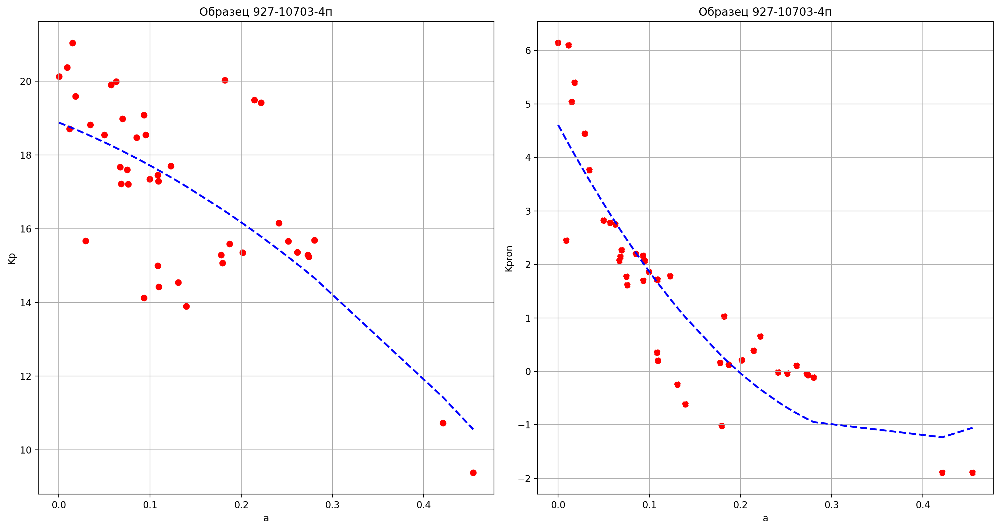

In [36]:
# Для параметра a

fig = plt.figure(figsize=(15,8), dpi=200)

nrows = 1
ncols = 2

gs = GridSpec(nrows, ncols, fig)

for samp in sample_dict:
    
    Kpor = sample_dict[samp]['Кп'][0]
    Kpor_array.append(Kpor)
    
    Kpron = sample_dict[samp]['Кпр'][0]
    Kpron_array.append(Kpron)
    
    a = sample_dict[samp]['a'][0]
    a_array.append(a)
    
    b = sample_dict[samp]['b'][0]
    b_array.append(b)

b_array, a_array
    
ax1 = fig.add_subplot(gs[0, 0])
ax1.scatter(a_array, Kpor_array, marker='o', color = 'r')  
ax1.plot(a_regr, K_por_regr, ls = '--', lw = 2, color = 'b')  

ax2 = fig.add_subplot(gs[0, 1])
ax2.scatter(a_array, np.log(Kpron_array), ls = '--', color = 'r')
ax2.plot(a_regr_pr, K_pron_regr, ls = '--', lw = 2, color = 'b') 

ax1.set_title(f'Образец {samp}')  
ax1.set_xlabel('a')
ax1.set_ylabel('Kp')
ax1.grid()
    
ax2.set_title(f'Образец {samp}')  
ax2.set_xlabel('a')
ax2.set_ylabel('Kpron')  
#ax2.set_yscale('log')
# ax2.set_ylim(-10, 40)
ax2.grid()

plt.tight_layout()  

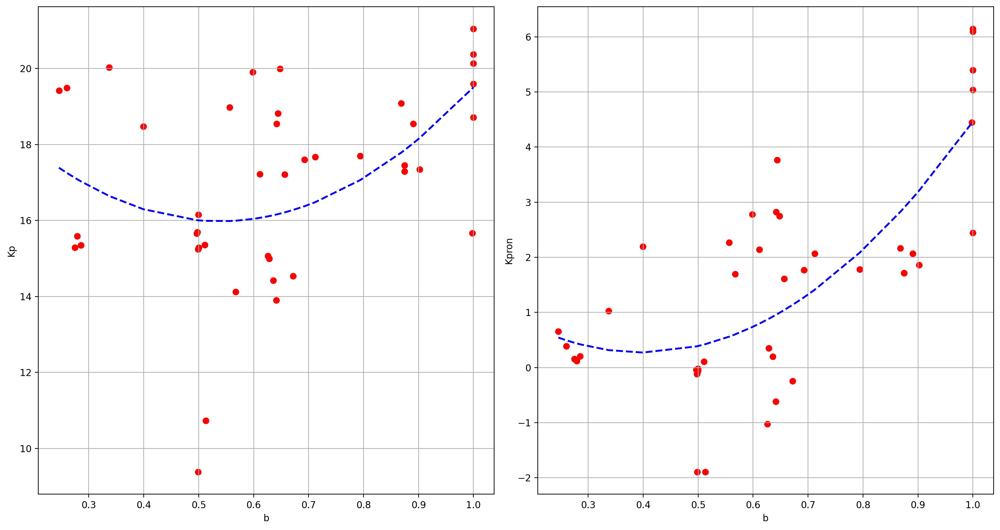

In [335]:
# Для b

fig = plt.figure(figsize=(15,8), dpi=200)

nrows = 1
ncols = 2

gs = GridSpec(nrows, ncols, fig)

ax1 = fig.add_subplot(gs[0, 0])
ax1.scatter(b_array, Kpor_array, marker='o', color = 'r')
ax1.plot(b_regr_por, K_por_regr_b, ls = '--', lw = 2, color = 'b')  

ax2 = fig.add_subplot(gs[0, 1])
ax2.scatter(b_array, np.log(Kpron_array),  marker='o', color = 'r')
ax2.plot(b_regr_pron, K_pron_regr_b, ls = '--', lw = 2, color = 'b') 

ax1.set_xlabel('b')
ax1.set_ylabel('Kp')
ax1.grid()
    
 
ax2.set_xlabel('b')
ax2.set_ylabel('Kpron') 
#ax2.set_yscale('log')
ax2.grid()

plt.tight_layout()  

Отсюда начинаем

In [64]:
from sklearn.metrics import mean_squared_error

params = np.polyfit(Kpor_array, a_array, deg = 2)

res = np.polyval(params, Kpor_array)
new_one = list(zip(Kpor_array, res))
last_one = sorted(new_one, key = lambda x: (x[0], x[1]))
Kpor_new = [i[0] for i in last_one]
a_new_por = [i[1] for i in last_one]
print(np.poly1d(params))

mean_squared_error(a_array, a_new_por)

          2
0.002386 x - 0.1063 x + 1.238


0.017980970485824258

In [65]:
from sklearn.metrics import mean_squared_error

params_a_pr = np.polyfit(np.log(Kpron_array), a_array, deg = 2)
           
res_a_pr = np.polyval(params_a_pr, np.log(Kpron_array))
new_one_a_pr = list(zip(np.log(Kpron_array), res_a_pr))
last_one_a_pr = sorted(new_one_a_pr, key = lambda x: (x[0], x[1]))
K_pron_regr  = [i[0] for i in last_one_a_pr]
a_regr_pr = [i[1] for i in last_one_a_pr]
print(np.poly1d(params_a_pr))

mean_squared_error(a_array, a_regr_pr)

          2
0.007526 x - 0.07758 x + 0.2102


0.020615988188035943

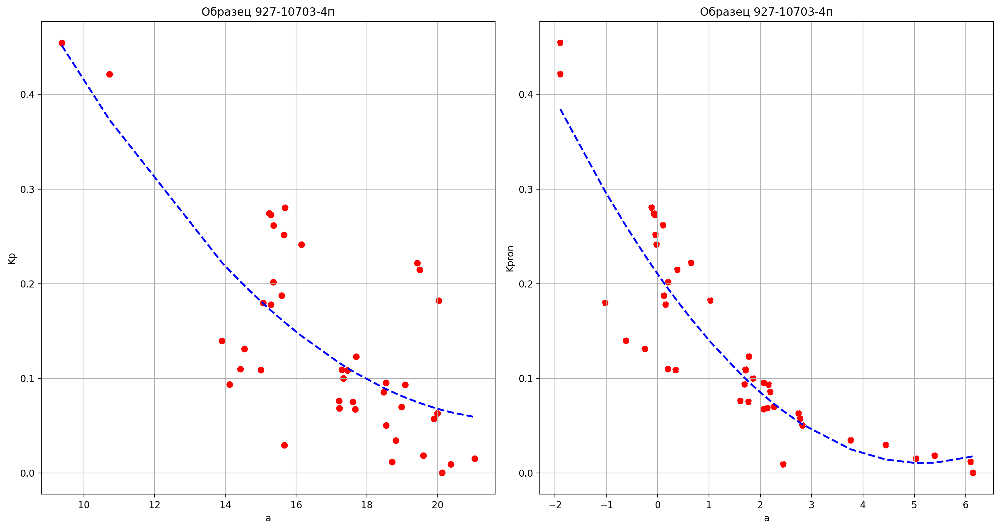

In [41]:
fig = plt.figure(figsize=(15,8), dpi=200)

nrows = 1
ncols = 2

gs = GridSpec(nrows, ncols, fig)
    
ax1 = fig.add_subplot(gs[0, 0])
ax1.scatter(Kpor_array, a_array, marker='o', color = 'r')  
ax1.plot(Kpor_new, a_new_por, ls = '--', lw = 2, color = 'b')  

ax2 = fig.add_subplot(gs[0, 1])
ax2.scatter(np.log(Kpron_array), a_array, ls = '--', color = 'r')
ax2.plot(K_pron_regr, a_regr_pr, ls = '--', lw = 2, color = 'b') 

ax1.set_title(f'Образец {samp}')  
ax1.set_xlabel('Kp')
ax1.set_ylabel('a')
ax1.grid()
    
ax2.set_title(f'Образец {samp}')  
ax2.set_xlabel('Kpron')
ax2.set_ylabel('a')  
#ax2.set_yscale('log')
# ax2.set_ylim(-10, 40)
ax2.grid()

plt.tight_layout()  

In [66]:
params_b_pron = np.polyfit(np.log(Kpron_array), b_array, deg = 2)

res_b_pron = np.polyval(params_b_pron, np.log(Kpron_array))
new_one_b_pron = list(zip(np.log(Kpron_array), res_b_pron))
last_one_b_pron = sorted(new_one_b_pron, key = lambda x: (x[0], x[1]))
K_pron_regr_b  = [i[0] for i in last_one_b_pron]
b_regr_pron = [i[1] for i in last_one_b_pron]
print(np.poly1d(params_b_pron))


mean_squared_error(b_array, b_regr_pron)

          2
0.005571 x + 0.0552 x + 0.5213


0.06539606107610238

In [67]:
params_b_por = np.polyfit(Kpor_array, b_array, deg = 2)

res_b_por = np.polyval(params_b_por, Kpor_array)
new_one_b_por = list(zip(Kpor_array, res_b_por))
last_one_b_por = sorted(new_one_b_por, key = lambda x: (x[0], x[1]))
K_por_regr_b = [i[0] for i in last_one_b_por]
b_regr_por = [i[1] for i in last_one_b_por]
print(np.poly1d(params_b_por))

mean_squared_error(b_array, b_regr_por)

          2
0.002312 x - 0.04479 x + 0.7183


0.051592495622566285

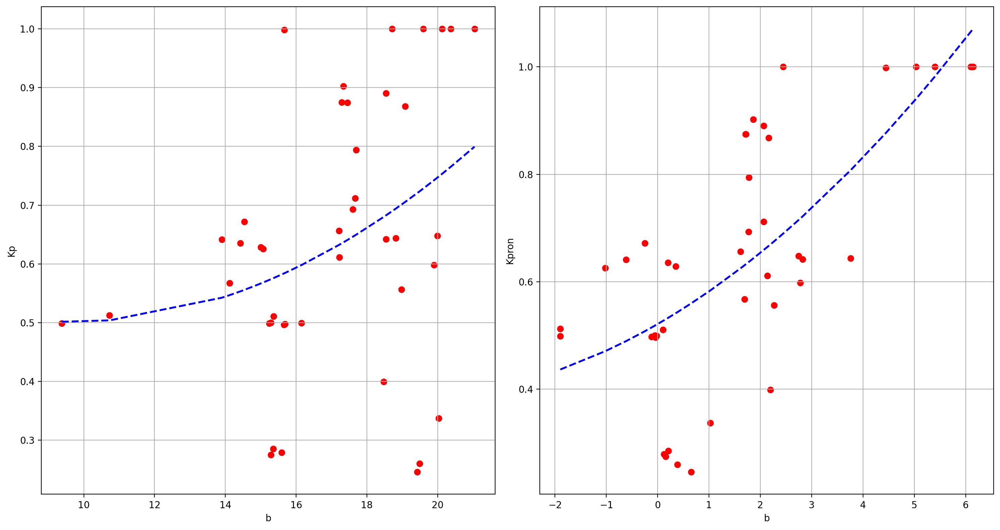

In [44]:
fig = plt.figure(figsize=(15,8), dpi=200)

nrows = 1
ncols = 2

gs = GridSpec(nrows, ncols, fig)

ax1 = fig.add_subplot(gs[0, 0])
ax1.scatter(Kpor_array, b_array, marker='o', color = 'r')
ax1.plot(K_por_regr_b, b_regr_por, ls = '--', lw = 2, color = 'b')  

ax2 = fig.add_subplot(gs[0, 1])
ax2.scatter(np.log(Kpron_array), b_array, marker='o', color = 'r')
ax2.plot(K_pron_regr_b, b_regr_pron, ls = '--', lw = 2, color = 'b') 

ax1.set_xlabel('Kp')
ax1.set_ylabel('b')
ax1.grid()
    
 
ax2.set_xlabel('Kpron')
ax2.set_ylabel('b') 
#ax2.set_yscale('log')
ax2.grid()

plt.tight_layout()  

Для коэффициента a возьмем Кп, для b - Кпр

In [ ]:
Добавим в словарь по-новому рассчитанные a и b и коэффициент Sw_min

In [45]:
new_sample_dict = {}

for name in samples:
    new_sample_dict[name[0][0]] = {'Кпр' : np.array(name[1]['Кпр, мД'].values),
                              'Кп': np.array(name[1]['Кп, %'].values),
                              'Pc': np.array(name[1]['Капиллярное давление, МПа'].values),
                              'Кв': np.array(name[1]['Текущая водонасыщенность Кв, %'].values)
}
new_sample_dict

{2041: {'Кпр': array([5.87, 5.87, 5.87, 5.87, 5.87, 5.87, 5.87]),
  'Кп': array([17.6, 17.6, 17.6, 17.6, 17.6, 17.6, 17.6]),
  'Pc': array([0.0379053, 0.0852844, 0.1516212, 0.2866481, 0.4643273, 0.6846487,
         0.9476123]),
  'Кв': array([82.57350958, 62.31454006, 49.04235231, 42.78392231, 38.52171567,
         34.74507688, 32.42514162])},
 2041.1: {'Кпр': array([5.01, 5.01, 5.01, 5.01, 5.01, 5.01, 5.01]),
  'Кп': array([17.21, 17.21, 17.21, 17.21, 17.21, 17.21, 17.21]),
  'Pc': array([0.0377639, 0.0849713, 0.1510556, 0.2855876, 0.4626103, 0.6821136,
         0.9440975]),
  'Кв': array([85.12465374, 60.49861496, 48.94736842, 42.54847645, 38.64265928,
         34.95844875, 32.27146814])},
 2042: {'Кпр': array([0.78, 0.78, 0.78, 0.78, 0.78, 0.78, 0.78]),
  'Кп': array([14.54, 14.54, 14.54, 14.54, 14.54, 14.54, 14.54]),
  'Pc': array([0.0374811, 0.084335 , 0.1499345, 0.2834666, 0.4591662, 0.6770333,
         0.937078 ]),
  'Кв': array([94.79406919, 82.1416804 , 70.34596376, 63.2289950

In [59]:
def optimal_new(a, b, Pc, Sw_min):
    
    alpha = (Pc/a)**(1/b)
    return (alpha * Sw_min + 100)/(1+alpha)

In [68]:
for samp in new_sample_dict:
    
    Kpor = new_sample_dict[samp]['Кп'][0]
    Kpron = new_sample_dict[samp]['Кпр'][0]
    Pc = new_sample_dict[samp]['Pc']
    
    # Здесь возьмем минSw - Ков
    Sw = new_sample_dict[samp]['Кв']
    Sw_min = Sw.min() - 0.05
    
    
    # a = 0.002386 Kpor^2 - 0.1063 Kpor + 1.238
    
    a = 0.002386*Kpor**2 - 0.1063*Kpor + 1.238
    
    # b = 0.002312 Kpor^2 - 0.04479 Kpor + 0.7183
    
    b = 0.002312*Kpor**2 - 0.04479*Kpor + 0.7183

    
    # Рассчитаем по формуле
    
    Sw_use = optimal_new(a, b, Pc, Sw_min)

    # Добавим в словарь значения
    new_sample_dict[samp]['Кв_расчет'] = np.array(Sw_use)
new_sample_dict    
    
    
    

{2041: {'Кпр': array([5.87, 5.87, 5.87, 5.87, 5.87, 5.87, 5.87]),
  'Кп': array([17.6, 17.6, 17.6, 17.6, 17.6, 17.6, 17.6]),
  'Pc': array([0.0379053, 0.0852844, 0.1516212, 0.2866481, 0.4643273, 0.6846487,
         0.9476123]),
  'Кв': array([82.57350958, 62.31454006, 49.04235231, 42.78392231, 38.52171567,
         34.74507688, 32.42514162]),
  'Кв_расчет': array([88.58816769, 71.8734959 , 57.10202403, 44.34722168, 38.63310252,
         35.95597595, 34.58674597])},
 2041.1: {'Кпр': array([5.01, 5.01, 5.01, 5.01, 5.01, 5.01, 5.01]),
  'Кп': array([17.21, 17.21, 17.21, 17.21, 17.21, 17.21, 17.21]),
  'Pc': array([0.0377639, 0.0849713, 0.1510556, 0.2855876, 0.4626103, 0.6821136,
         0.9440975]),
  'Кв': array([85.12465374, 60.49861496, 48.94736842, 42.54847645, 38.64265928,
         34.95844875, 32.27146814]),
  'Кв_расчет': array([90.09362416, 74.12965662, 58.97350849, 45.25693944, 38.99535598,
         36.06289379, 34.57235378])},
 2042: {'Кпр': array([0.78, 0.78, 0.78, 0.78, 0.78,

In [69]:
# Визуализируем оптимальную модель, рассчитанную по а и б и фактическую


fig = plt.figure(figsize=(20,80), dpi=200)

nrows = 14
ncols = 3

gs = GridSpec(nrows, ncols, fig)

rows = [i for i in range(14)]

count_cols = 0

for samp in sample_dict:
    
    # рисуем графики
    ax = fig.add_subplot(gs[rows[0], count_cols])

    Sw = sample_dict[samp]['Кв']
    Pc = sample_dict[samp]['Pc']

    # Фактическая
    ax.plot(Sw, Pc, marker = 'o', color = 'b', label = 'Фактическая кривая')

    
    # Оптимальная модель
    optimal_array = optimal_dict[samp]
    ax.plot(optimal_array, Pc, marker = 'o', color = 'r', ls = ':', label = 'Оптимальная')
    
    # С рассчитанным Кв
    Sw_calculated = new_sample_dict[samp]['Кв_расчет']
    ax.plot(Sw_calculated, Pc, marker = 'o', color = 'g', ls = ':', label = 'Рассчитанная')
    
        
    ax.set_title(f'Образец {samp}')
        
    ax.set_xlabel('Ков, %')
    ax.set_ylabel('Pc, МПа')
    ax.set_yscale('log')
        
    ax.set_xlim(0, 105) 
    ax.set_ylim(10**-2.5, 10**1.4)
    ax.legend()
        
    ax.grid()
    

    count_cols+=1
    if count_cols > 2:
        rows = rows[1:]
        count_cols = 0
    
    if len(rows) == 0:
        break
    
        
    
plt.tight_layout()     

In [99]:
sw_fes_error = []

for samp in sample_dict:
    
    Sw = sample_dict[samp]['Кв']
    
    sw_value = new_sample_dict[samp]['Кв_расчет']
    
    sw_fes_error.append(np.sqrt(mean_squared_error(Sw, sw_value)))

    
sw_fes_error_mean = np.mean(np.array(sw_fes_error))
print(f'Оптимальная: {optimal_error_mean}, По ФЕС: {sw_fes_error_mean}')

Оптимальная: 2.0558533419946703, По ФЕС: 8.831466883669206
